# Question 1


### RNN as Generative Model

In [66]:
import tensorflow as tf
from tensorflow.keras.datasets import mnist
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.layers import LSTM, Dense, Input,Concatenate, Bidirectional, BatchNormalization, Dropout, Attention
from tensorflow.keras.models import Sequential, Model
(x_train, y_train), (x_test, y_test) = mnist.load_data()

In [67]:
x_test.shape

(10000, 28, 28)

In [68]:
y_train.shape

(60000,)

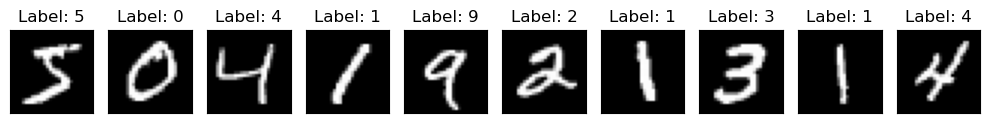

In [69]:
x_train = x_train.reshape(-1, 28, 28) / 255.0
x_test = x_test.reshape(-1, 28, 28) / 255.0

num_viz = 10
plt.figure(figsize=(10,10))
for i in range(num_viz):
    ax = plt.subplot(1, 10, i+1)
    plt.imshow(x_train[i], cmap='gray')
    plt.title("Label: {}".format(y_train[i]))
    plt.xticks([])
    plt.yticks([]) 

plt.tight_layout() 
plt.show()


In [70]:
def extract_patches_and_vectorize(image):
    patches = []
    
    for i in range(0, 28, 7):
        for j in range(0, 28, 7):
            patch = image[i:i+7, j:j+7].flatten()
            patches.append(patch)
    return np.array(patches)

x_train_patches = np.array([extract_patches_and_vectorize(image) for image in x_train])
x_test_patches = np.array([extract_patches_and_vectorize(image) for image in x_test])


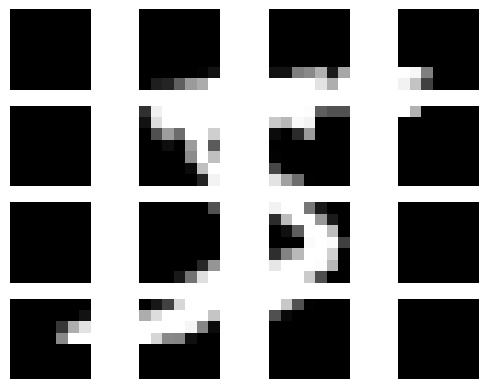

In [71]:
for i in range(x_train_patches.shape[1]):
    plt.subplot(4, 4, i + 1)  
    plt.imshow(x_train_patches[0][i].reshape((7, 7)), cmap='gray')
    plt.axis('off')


In [72]:
x_train_patches.shape

(60000, 16, 49)

In [73]:
x_test_patches.shape

(10000, 16, 49)

In [76]:
sequence_input = Input(shape=(15, 49), name='sequence_input')
lstm_layer, state_h, state_c = LSTM(64, return_sequences=True, return_state=True)(sequence_input)
dense_layer = Dense(49, activation='sigmoid')(lstm_layer)
model = Model(inputs=sequence_input, outputs=[dense_layer, state_h, state_c])
model.compile(optimizer='adam', loss=['mse', None, None])
model.summary()


Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequence_input (InputLayer)  [(None, 15, 49)]         0         
                                                                 
 lstm_8 (LSTM)               [(None, 15, 64),          29184     
                              (None, 64),                        
                              (None, 64)]                        
                                                                 
 dense_4 (Dense)             (None, 15, 49)            3185      
                                                                 
Total params: 32,369
Trainable params: 32,369
Non-trainable params: 0
_________________________________________________________________


In [77]:
epochs = 100
batch_size=100
test_losses=[]
train_losses=[]
for epoch in range(epochs):
    indices = np.arange(len(x_train_patches))
    np.random.shuffle(indices)
    x_train_shuffled = x_train_patches[indices]

    for i in range(0, len(x_train_shuffled), batch_size):
        x_batch = x_train_shuffled[i:i+batch_size,:15]
        y_batch = np.roll(x_batch, shift=-1, axis=1)  

        loss = model.train_on_batch(x_batch, y_batch)
    train_losses.append(loss)
    x_test_pred,_,_ = model.predict(x_test_patches[:, :-1, :])  
    test_loss = np.mean(np.square(x_test_pred - x_test_patches[:, 1:, :])) 
    print(f"Epoch {epoch + 1}/{epochs}, Loss: {loss}, Test Loss: {test_loss}")

    if epoch > 40 and test_loss > np.min(test_losses[-5:]):
        print("Early stopping as test loss is increasing.")
        break

    test_losses.append(test_loss)

313/313 [==============================] - 1s 3ms/step
Epoch 1/100, Loss: [0.06809832900762558, 0.06809832900762558], Test Loss: 0.06860233655749945
313/313 [==============================] - 1s 3ms/step
Epoch 2/100, Loss: [0.05971193313598633, 0.05971193313598633], Test Loss: 0.05540381752075744
313/313 [==============================] - 1s 3ms/step
Epoch 3/100, Loss: [0.049155689775943756, 0.049155689775943756], Test Loss: 0.0490882729840519
313/313 [==============================] - 1s 3ms/step
Epoch 4/100, Loss: [0.043583668768405914, 0.043583668768405914], Test Loss: 0.0452417094779404
313/313 [==============================] - 1s 3ms/step
Epoch 5/100, Loss: [0.04260799288749695, 0.04260799288749695], Test Loss: 0.042821531332668576
313/313 [==============================] - 1s 3ms/step
Epoch 6/100, Loss: [0.03984338045120239, 0.03984338045120239], Test Loss: 0.04116290910537561
313/313 [==============================] - 1s 3ms/step
Epoch 7/100, Loss: [0.041307684034109116, 0.0413

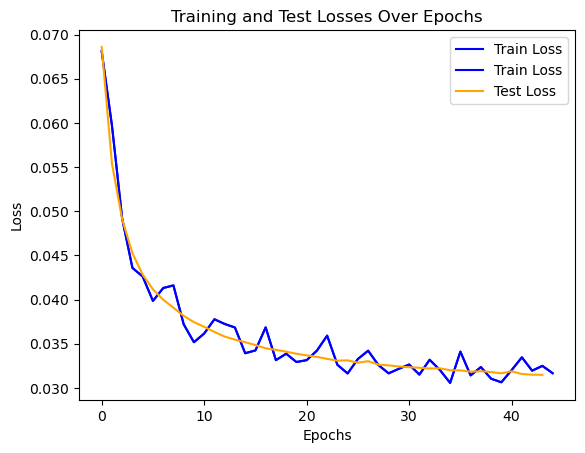

In [78]:
model.save("q1_rnn_model.h5")

plt.plot(train_losses, label='Train Loss', color='blue')
plt.plot(test_losses, label='Test Loss', color='orange')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Test Losses Over Epochs')
plt.legend()
plt.show()


In [79]:
model= tf.keras.models.load_model("q1_rnn_model.h5")

In [128]:
total_digit_class =10

ten_image_10_class=[]

for one_digit in range(total_digit_class):
    indices = np.where(y_test == one_digit)[0]
    selected_indices = np.random.choice(indices, size=10, replace=False)
    selected_images = x_test[selected_indices]
    ten_image_10_class.append(selected_images)
    


In [241]:
ten_image_10_class_patches=np.array([[extract_patches_and_vectorize(ten_image_10_class[digit][image]) for image in range(10)] for digit in range(10)])

In [242]:
generated_images = []

for d in range(10):
    for i in range(10):
        
        image = ten_image_10_class_patches[d][i]
        top_half = image[:8, :].reshape(1,8,49)
        # intializing the bottom half zero
        bottom_half = np.zeros_like(top_half)

        input_sequence = np.concatenate([top_half, bottom_half], axis=1)

        input_sequence = input_sequence.reshape((1, 16, 49))
        
        for t in range(8, 16):
            generated_bottom_half, _, _ = model.predict(input_sequence[:, :t, :])
            input_sequence[:, t, :] = generated_bottom_half[:,-1,:].reshape(1,1,49)

        generated_sequence = np.concatenate([top_half, input_sequence[:, 8:, :]], axis=1)
        generated_images.append(generated_sequence.reshape(16,49))



1/1 [==============================] - 0s 18ms/step


In [244]:
import matplotlib.pyplot as plt

def reconstruct_image(vectorized_patches):
    num_patches = vectorized_patches.shape[0]
    patch_size = int(np.sqrt(vectorized_patches.shape[1]))
    
    image_size = int(np.sqrt(num_patches)) * patch_size
    reconstructed_image = np.zeros((image_size, image_size))

    for i in range(num_patches):
        row = i // int(np.sqrt(num_patches))
        col = i % int(np.sqrt(num_patches))
        reconstructed_image[row * patch_size:(row + 1) * patch_size, col * patch_size:(col + 1) * patch_size] = vectorized_patches[i].reshape((patch_size, patch_size))

    return reconstructed_image

In [245]:
rec_set= [[reconstruct_image(generated_images[j*10+i]) for i in range(10)] for j in range(10)]

In [246]:
def plotting_img(images,title):
    fig, axs = plt.subplots(10, 10, figsize=(5, 5))
    for i in range(10):
        for j in range(10):
            image = images[i][j]
            axs[i, j].imshow(image, cmap='gray')
            axs[i, j].axis('off')
    plt.suptitle(title)
    plt.tight_layout() 

    plt.show()


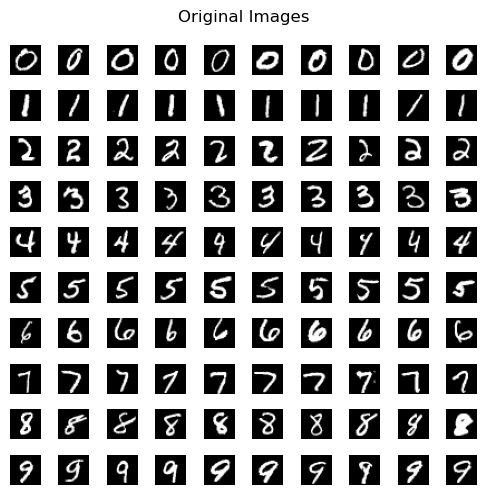

In [247]:
plotting_img(ten_image_10_class,"Original Images")

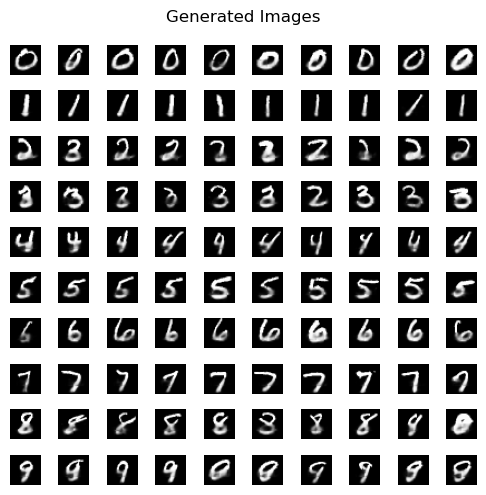

In [248]:
plotting_img(rec_set,"Generated Images")

# Question 2

In [171]:
import numpy as np
import matplotlib.pyplot as plt
import pickle
from tensorflow.keras.layers import Input,Conv2D, Dense, Reshape, Conv2DTranspose, Flatten, Lambda
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model


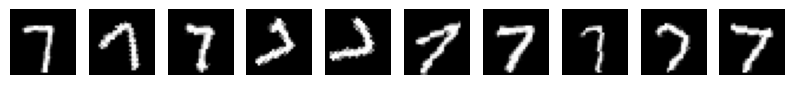

In [172]:
with open('hw5_tr7.pkl', 'rb') as f:
    train_data = pickle.load(f)

num_images_to_visualize = 10
plt.figure(figsize=(10,10))

for i in range(num_images_to_visualize):
    plt.subplot(1, num_images_to_visualize, i + 1)
    plt.imshow(train_data[i], cmap='gray')
    plt.axis('off')

plt.show()

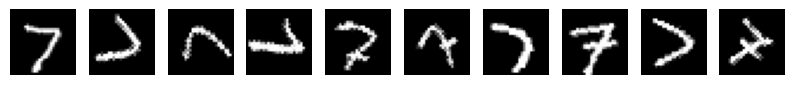

In [173]:
with open('hw5_te7.pkl', 'rb') as f:
    test_data = pickle.load(f)

num_images_to_visualize = 10
plt.figure(figsize=(10,10))

for i in range(num_images_to_visualize):
    plt.subplot(1, num_images_to_visualize, i + 1)
    plt.imshow(test_data[i], cmap='gray')
    plt.axis('off')

plt.show()

In [174]:
train_data.shape

(6265, 28, 28)

In [175]:
test_data.shape

(1028, 28, 28)

In [176]:
train_data = train_data.reshape((-1, 28, 28, 1))
test_data = test_data.reshape((-1, 28, 28, 1))

In [177]:
z_mean =0
z_log_var=0

In [193]:
latent_dim = 3  

encoder_inputs = Input(shape=(28, 28, 1))
x = Conv2D(16, 3, activation='relu', )(encoder_inputs)
x = Conv2D(64, 3, activation='relu', )(x)
x = Flatten()(x)
x = Dense(128)(x)


z_mean = Dense(latent_dim)(x)
z_log_var = Dense(latent_dim)(x)
def sampling(args):
    z_mean, z_log_var = args
    batch = tf.shape(z_mean)[0]
    dim = tf.shape(z_mean)[1]
    epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
    return z_mean + tf.exp(0.5 * z_log_var) * epsilon

z = Lambda(sampling, output_shape=(latent_dim,))([z_mean, z_log_var])

decoder = Sequential()
decoder.add(Dense(latent_dim*2, input_shape=(latent_dim,), activation='relu'))
decoder.add(Dense(28*28, activation='relu'))
decoder.add(Reshape((28,28,1)))
decoder.add(Conv2DTranspose(64, 3, activation='relu', padding='same'))
decoder.add(Conv2DTranspose(16, 3, activation='relu', padding='same'))
decoder.add(Conv2DTranspose(1, 3, activation='sigmoid',padding="same"))
decoder_outputs=decoder(z)

vae = Model(encoder_inputs, decoder_outputs)

rec_loss = tf.keras.losses.binary_crossentropy(tf.keras.backend.flatten(encoder_inputs), tf.keras.backend.flatten(decoder_outputs))
kl_loss = -0.5 * tf.reduce_sum(1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var), axis=-1)
kl_loss = kl_loss / (784)
vae_loss = tf.keras.backend.mean(rec_loss + kl_loss)

vae.add_loss(vae_loss)

vae.compile(loss=None,optimizer='adam')


In [194]:
vae.fit(train_data,train_data, epochs=40, batch_size=200,shuffle=True,validation_data=(test_data,test_data))


Epoch 1/40
32/32 [==============================] - 9s 200ms/step - loss: 0.4969 - val_loss: 0.3138
Epoch 2/40
32/32 [==============================] - 6s 193ms/step - loss: 0.2798 - val_loss: 0.2512
Epoch 3/40
32/32 [==============================] - 6s 193ms/step - loss: 0.2404 - val_loss: 0.2137
Epoch 4/40
32/32 [==============================] - 6s 195ms/step - loss: 0.2095 - val_loss: 0.1960
Epoch 5/40
32/32 [==============================] - 6s 193ms/step - loss: 0.1990 - val_loss: 0.1907
Epoch 6/40
32/32 [==============================] - 6s 196ms/step - loss: 0.1946 - val_loss: 0.1865
Epoch 7/40
32/32 [==============================] - 6s 194ms/step - loss: 0.1903 - val_loss: 0.1814
Epoch 8/40
32/32 [==============================] - 6s 193ms/step - loss: 0.1858 - val_loss: 0.1774
Epoch 9/40
32/32 [==============================] - 6s 195ms/step - loss: 0.1818 - val_loss: 0.1742
Epoch 10/40
32/32 [==============================] - 6s 196ms/step - loss: 0.1795 - val_loss: 0.1736

In [195]:
vae.summary()

Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 28, 28, 1)]  0           []                               
                                                                                                  
 conv2d_12 (Conv2D)             (None, 26, 26, 16)   160         ['input_4[0][0]']                
                                                                                                  
 conv2d_13 (Conv2D)             (None, 24, 24, 64)   9280        ['conv2d_12[0][0]']              
                                                                                                  
 flatten_4 (Flatten)            (None, 36864)        0           ['conv2d_13[0][0]']              
                                                                                            

In [196]:
vae.save("q2_vae_model.h5")

1/1 [==============================] - 0s 232ms/step


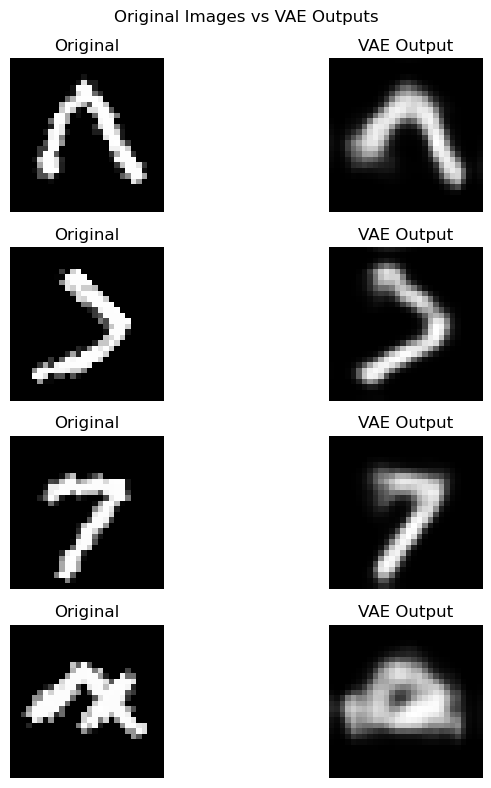

In [197]:
num_images_to_display = 4

random_indices = np.random.choice(len(test_data), num_images_to_display, replace=False)
selected_images = test_data[random_indices]

vae_outputs = vae.predict(selected_images)

fig, axes = plt.subplots(num_images_to_display, 2, figsize=(8, 2 * num_images_to_display))
fig.suptitle('Original Images vs VAE Outputs')

for i in range(num_images_to_display):
    axes[i, 0].imshow(selected_images[i].reshape(28, 28), cmap='gray')
    axes[i, 0].axis('off')
    axes[i, 0].set_title('Original')

    axes[i, 1].imshow(vae_outputs[i].reshape(28, 28), cmap='gray')
    axes[i, 1].axis('off')
    axes[i, 1].set_title('VAE Output')
plt.tight_layout() 
plt.show()


In [198]:
def plot_images(images):
    n = len(images)
    plt.figure(figsize=(20, 20 * n))
    for i in range(n):
        ax = plt.subplot(1, n, i + 1)
        plt.imshow(images[i])
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_xticks([])
        ax.set_yticks([])


1/1 [==============================] - 0s 133ms/step


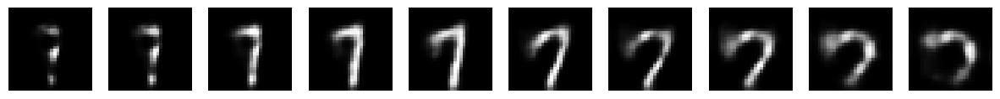

1/1 [==============================] - 0s 31ms/step


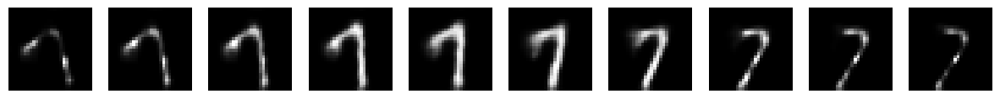

1/1 [==============================] - 0s 31ms/step


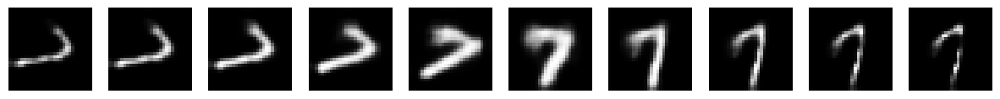

In [199]:
import numpy as np
import matplotlib.pyplot as plt

def generate_and_display_images(model, latent_dim, fixed_values, varying_dim_index, num_samples=10):
    varying_values = np.linspace(-5.0, 5.0, num_samples).reshape(-1, 1)
    latent_codes = np.tile(fixed_values, (num_samples, 1))
    latent_codes[:, varying_dim_index] = varying_values.flatten()
    generated_images = model.predict(latent_codes)

    plt.figure(figsize=(15, 2))
    for i in range(num_samples):
        ax = plt.subplot(1, num_samples, i + 1)
        plt.imshow(generated_images[i, :, :, 0], cmap='gray')
        ax.axis('off')
    plt.show()


fixed_values = np.random.normal(size=(1, latent_dim))

generate_and_display_images(decoder, latent_dim, fixed_values, 0)
generate_and_display_images(decoder, latent_dim, fixed_values, 1)
generate_and_display_images(decoder, latent_dim, fixed_values, 2)


**By Looking at the images generated by VAE in third case where 3rd latent dimention is variable we can see the the gradual effect on 7 is rotation. All other 7 looks almost similar.**

# Question 3


In [49]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Embedding, Concatenate, LeakyReLU
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

In [36]:
(x_train, y_train), (_, _) = tf.keras.datasets.mnist.load_data()
x_train = (x_train.astype(np.float32) - 127.5) / 127.5  # Normalize to the range [-1, 1]
x_train = x_train.reshape(x_train.shape[0], 28, 28, 1)

In [37]:
num_classes=10
d=100

In [38]:
def build_generator():
    
    model_input =Input(shape=(110,))
    x = Dense(256, activation='relu')(model_input)
    x = Dense(512, activation='relu')(x)
    x = Dense(1024, activation='relu')(x)
    x = Dense(784, activation='tanh')(x)
    
    generated_image = x
    
    generator = Model(model_input, generated_image)
    return generator

generator = build_generator()

In [39]:
def build_discriminator():
    image = Input(shape=(794,))    
    x = Dense(1024, activation='relu')(image)
    x = Dense(512, activation='relu')(x)
    x = Dense(256, activation='relu')(x)
    
    validity = Dense(1, activation='sigmoid')(x)
    
    discriminator = Model(image, validity)
    return discriminator

discriminator = build_discriminator()

In [40]:
discriminator.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0001), metrics=['accuracy'])

discriminator.trainable = False

model_input = Input(shape=(110,))

generated_image = generator(model_input)
validity = discriminator(tf.concat([generated_image, tf.slice(model_input, [0, d], [-1, 10])], axis=1))

combined_model = Model(model_input, validity)

combined_model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0001))

In [41]:
num_epochs = 100
batch_size = 100
half_batch = batch_size // 2

real_classification_accuracy =[]
fake_classification_accuracy =[]

for epoch in range(num_epochs):
    for i in range(x_train.shape[0] // batch_size):
        idx = np.random.randint(0, x_train.shape[0], half_batch)
        real_images, labels = x_train[idx], y_train[idx]
        real_images = real_images.reshape(-1,784)
        real_labels = tf.one_hot(labels, depth=10)
        real=tf.concat([real_images, real_labels], axis=1)
        
        fake_labels_internal = tf.one_hot(np.random.randint(0, 10, half_batch), depth=num_classes)
        fake_images = generator.predict(tf.concat([np.random.randn(half_batch, 100), fake_labels_internal],axis=1))
        fake=tf.concat([fake_images, fake_labels_internal],axis=1)
        
        real_labels = np.ones((half_batch, 1))
        fake_labels = np.zeros((half_batch, 1))

        d_loss_real, d_accuracy_real = discriminator.train_on_batch(real, real_labels)
        d_loss_fake, d_accuracy_fake = discriminator.train_on_batch(fake, fake_labels)
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

        noise = np.random.randn(batch_size, 100)
        noise_labels=tf.one_hot(np.random.randint(0, 10, batch_size), depth=num_classes)
        valid_labels = np.ones((batch_size, 1))
        combined_noise=tf.concat([noise, noise_labels],axis=1)
        g_loss = combined_model.train_on_batch(combined_noise, valid_labels)

        print(f"Epoch {epoch + 1}, Step {i + 1}/{x_train.shape[0] // batch_size}, D Loss: {d_loss}, G Loss: {g_loss}")
    real_classification_accuracy.append(d_accuracy_real)
    fake_classification_accuracy.append(d_accuracy_fake)

generator.save_weights('generator_weights.h5')

2/2 [==============================] - 0s 2ms/step
Epoch 1, Step 1/600, D Loss: 0.6229207962751389, G Loss: 0.6282433867454529
2/2 [==============================] - 0s 2ms/step
Epoch 1, Step 2/600, D Loss: 0.4648047536611557, G Loss: 0.6132249236106873
2/2 [==============================] - 0s 2ms/step
Epoch 1, Step 3/600, D Loss: 0.4355562571436167, G Loss: 0.6157044768333435
2/2 [==============================] - 0s 2ms/step
Epoch 1, Step 4/600, D Loss: 0.4265408040955663, G Loss: 0.6208247542381287
2/2 [==============================] - 0s 2ms/step
Epoch 1, Step 5/600, D Loss: 0.40935252513736486, G Loss: 0.6279304027557373
2/2 [==============================] - 0s 2ms/step
Epoch 1, Step 6/600, D Loss: 0.4011127839330584, G Loss: 0.6474299430847168
2/2 [==============================] - 0s 2ms/step
Epoch 1, Step 7/600, D Loss: 0.39107688050717115, G Loss: 0.6743640899658203
2/2 [==============================] - 0s 2ms/step
Epoch 1, Step 8/600, D Loss: 0.37651653797365725, G Loss: 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2/2 [==============================] - 0s 2ms/step
Epoch 37, Step 584/600, D Loss: 0.004436067536062183, G Loss: 5.931429862976074
2/2 [==============================] - 0s 2ms/step
Epoch 37, Step 585/600, D Loss: 0.019094000980999226, G Loss: 7.164302349090576
2/2 [==============================] - 0s 2ms/step
Epoch 37, Step 586/600, D Loss: 0.003005246791872196, G Loss: 9.937368392944336
2/2 [==============================] - 0s 2ms/step
Epoch 37, Step 587/600, D Loss: 0.00031678365121479146, G Loss: 12.265027046203613
2/2 [==============================] - 0s 2ms/step
Epoch 37, Step 588/600, D Loss: 4.175617527835129e-05, G Loss: 13.881797790527344
2/2 [==============================] - 0s 2ms/step
Epoch 37, Step 589/600, D Loss: 0.024137431807048415, G Loss: 13.220911979675293
2/2 [==============================] - 0s 2ms/step
Epoch 37, Step 590/600, D Loss: 0.15308733408892294, G Loss: 8.464776992797852
2/2 [==============================] - 0s 2ms/step
Epoch 37, Step 591/600, D L

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 43, Step 283/600, D Loss: 0.023904759902507067, G Loss: 5.563587188720703
2/2 [==============================] - 0s 2ms/step
Epoch 43, Step 284/600, D Loss: 0.05536608397960663, G Loss: 5.947305202484131
2/2 [==============================] - 0s 2ms/step
Epoch 43, Step 285/600, D Loss: 0.004231163649819791, G Loss: 6.5624003410339355
2/2 [==============================] - 0s 2ms/step
Epoch 43, Step 286/600, D Loss: 0.017118172720074654, G Loss: 6.404783725738525
2/2 [==============================] - 0s 2ms/step
Epoch 43, Step 287/600, D Loss: 0.008897649822756648, G Loss: 6.373302459716797
2/2 [==============================] - 0s 2ms/step
Epoch 43, Step 288/600, D Loss: 0.0434795506298542, G Loss: 6.6209330558776855
2/2 [==============================] - 0s 2ms/step
Epoch 43, Step 289/600, D Loss: 0.004783879383467138, G Loss: 7.990825176239014
2/2 [==============================] - 0s 2ms/step
Epoch 43, Step 290/600, D Loss: 0.048953431367408484, G Loss: 7.3099565505981445
2/2

In [42]:
generator.save_weights("q3_cgan.h5")
generator.save("q3_cgan.h5")

100
100


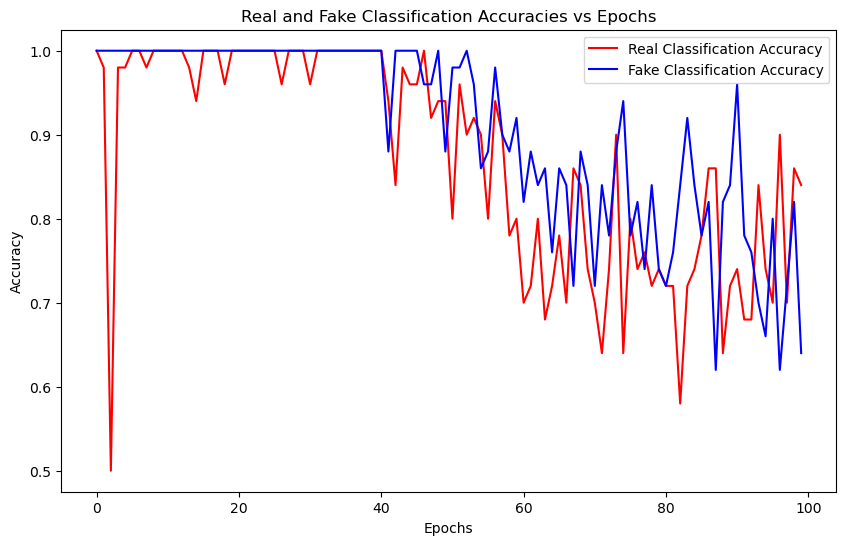

In [43]:
plt.figure(figsize=(10, 6))

plt.plot(np.arange(num_epochs),real_classification_accuracy, color='red', label='Real Classification Accuracy')
plt.plot(np.arange(num_epochs), fake_classification_accuracy, color='blue', label='Fake Classification Accuracy')

plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Real and Fake Classification Accuracies vs Epochs')

plt.legend()
plt.show()


In [52]:
def generate_test_examples(generator, num_examples_per_class=10):
    fig, axes = plt.subplots(10, num_examples_per_class, figsize=(num_examples_per_class, 10))
    for digit in range(10):
        for i in range(num_examples_per_class):
            random_vector = tf.random.normal((1, 100))
            label = tf.reshape(tf.one_hot(digit, depth=num_classes),(1,num_classes))
            generated_image=generator.predict(tf.concat([random_vector, label],axis=1))
            axes[digit, i].imshow(generated_image.reshape(28, 28), cmap='gray')
            axes[digit, i].axis('off')

    plt.show()
    

1/1 [==============================] - 0s 19ms/step


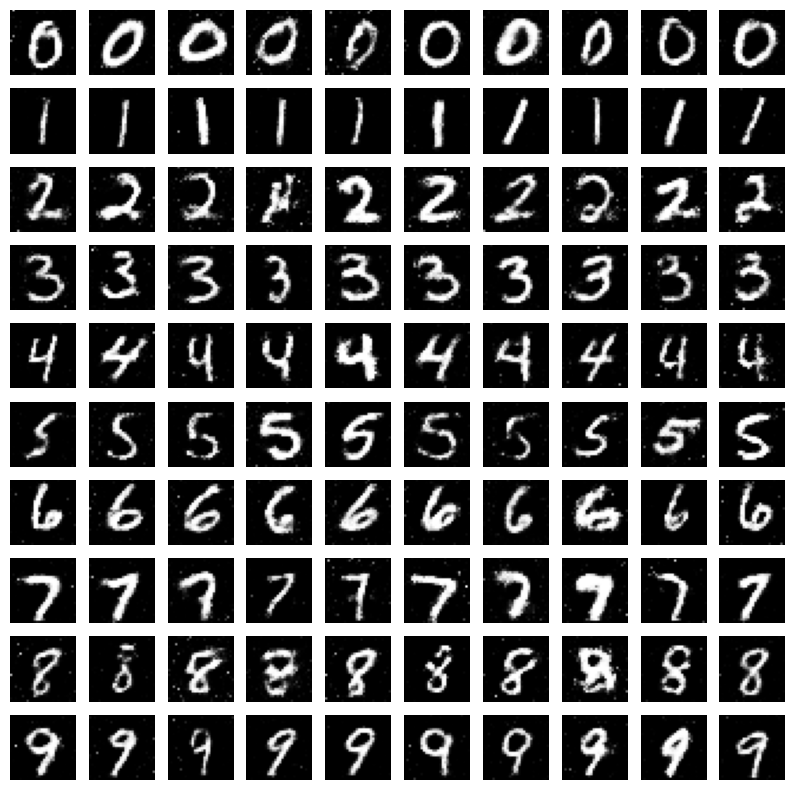

In [ ]:
generate_test_examples(generator)

1/1 [==============================] - 0s 20ms/step


(-0.5, 27.5, 27.5, -0.5)

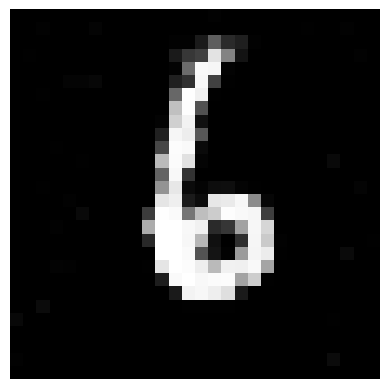

In [54]:
label = tf.reshape(tf.one_hot(6, depth=num_classes),(1,num_classes))
random_vector = tf.random.normal((1, 100))
generated_image=generator.predict(tf.concat([random_vector, label],axis=1))
plt.imshow(generated_image.reshape(28, 28), cmap='gray')
plt.axis('off')


# Question 4

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Embedding, Concatenate, LeakyReLU, Dropout,BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

In [26]:
(x_train,y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()
x_train = (x_train.astype(np.float32) - 127.5) / 127.5  
x_test = (x_test.astype(np.float32) - 127.5) / 127.5  
center_patches = x_train[:, 10:20, 10:20].reshape(x_train.shape[0], 100)

In [12]:
def build_generator():
    model_input =Input(shape=(200,))
    x = Dense(200, activation='relu',kernel_initializer='HeNormal')(model_input)
    x = BatchNormalization(momentum=0.5)(x)
    
    x = Dense(400, activation='relu',kernel_initializer='HeNormal')(x)
    x = BatchNormalization(momentum=0.5)(x)
    
    x = Dense(784, activation='tanh',kernel_initializer='HeNormal')(x)
    
    generated_image = x
    generator = Model(model_input, generated_image)
    return generator

generator = build_generator()

In [13]:
def build_discriminator():
    image = Input(shape=(784,))  
    
    x = Dense(400,kernel_initializer='HeNormal')(image)
    x = LeakyReLU(0.2)(x)
    x = Dropout(0.1)(x)
    
    x = Dense(200,kernel_initializer='HeNormal')(x)
    x = LeakyReLU(0.2)(x)
    x = Dropout(0.1)(x)
    
    x = Dense(100,kernel_initializer='HeNormal')(x)
    x = LeakyReLU(0.2)(x)
    x = Dropout(0.1)(x)

    validity = Dense(1, activation='sigmoid',kernel_initializer='GlorotNormal')(x)
    discriminator = Model(image, validity)
    return discriminator

discriminator = build_discriminator()

In [14]:
discriminator.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0001), metrics=['accuracy'])
discriminator.trainable = False

model_input = Input(shape=(200,))
generated_image = generator(model_input)

validity = discriminator(generated_image)
combined_model = Model(model_input, validity)

combined_model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=0.0001))

### Lambda =10

In [39]:
lambda_ = 10
epochs = 100
batch_size = 100

In [40]:
real_classification_accuracy =[]
fake_classification_accuracy =[]

for epoch in range(epochs):
    for i in range(x_train.shape[0] // batch_size):
        idx = np.random.normal(0,1,size = (batch_size, 100))
        
        real_image_index=i*batch_size
        real_center_p=center_patches[real_image_index:real_image_index+batch_size]
        gen_input = tf.concat([idx, real_center_p], axis=1)
        
        generated_images = generator.predict(gen_input)
        
        real_images = tf.reshape(x_train[np.random.randint(0, x_train.shape[0], batch_size)],(-1,784))
        
        labels_real = np.ones((batch_size, 1))
        labels_fake = np.zeros((batch_size, 1))
        discriminator.trainable = True

        d_loss_real, real_accuracy = discriminator.train_on_batch(real_images, labels_real)
        d_loss_fake, fake_accuracy = discriminator.train_on_batch(generated_images, labels_fake)
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
        
        gen_center_patch =generated_images.reshape(batch_size, 28,28)
        gen_center_patch=gen_center_patch[:, 10:20, 10:20].reshape(batch_size, 100)
        idx = np.random.normal(0,1,size = (batch_size, 100))

        gan_input = tf.concat([idx, center_patches[real_image_index:real_image_index+batch_size]], axis=1)
        discriminator.trainable = False

        g_loss = combined_model.train_on_batch(gan_input, labels_real)+(lambda_ * np.mean((gen_center_patch-real_center_p)**2))

        print(f"Epoch {epoch}, D Loss: {d_loss}, G Loss: {g_loss}")
    real_classification_accuracy.append(real_accuracy)
    fake_classification_accuracy.append(fake_accuracy)

4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.5602330416440964, G Loss: 13.753462314605713
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.41438134014606476, G Loss: 13.44375365972519
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.3821635115891695, G Loss: 13.814990222454071
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.33656000904738903, G Loss: 13.91959285736084
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.3324525700882077, G Loss: 13.898152232170105
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.32486214861273766, G Loss: 14.283116340637207
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.2727014869451523, G Loss: 14.284304022789001
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.2855637622997165, G Loss: 14.506694793701172
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.226878912

100
100


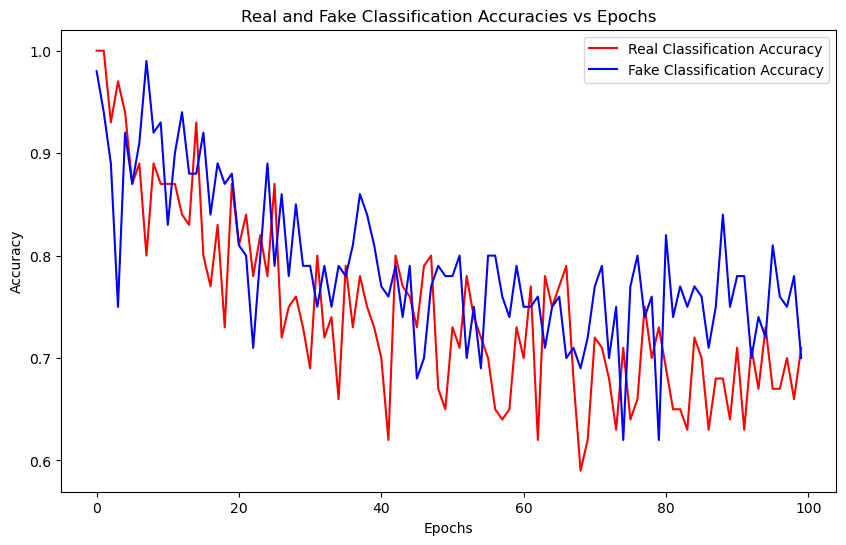

In [41]:
plt.figure(figsize=(10, 6))
print(len(real_classification_accuracy))
print(len(fake_classification_accuracy))

plt.plot(np.arange(epochs),real_classification_accuracy, color='red', label='Real Classification Accuracy')
plt.plot(np.arange(epochs), fake_classification_accuracy, color='blue', label='Fake Classification Accuracy')

plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Real and Fake Classification Accuracies vs Epochs')

plt.legend()
plt.show()


In [45]:
generator.save_weights("q4_imputing_gan_weights_l10.h5")
generator.save("q4_imputing_gan_model_l10.h5")

In [46]:
def generate_test_examples(generator, num_examples_per_class=10):
    fig, axes = plt.subplots(10, num_examples_per_class, figsize=(num_examples_per_class, 10))

    for digit in range(10):
        for i in range(num_examples_per_class):
            idx = tf.random.normal((1, 100))
            index=np.where(y_test == digit)[0][i]
            generated_image=generator.predict(tf.concat([idx,x_test[index, 10:20, 10:20].reshape(1, 100)],axis=1))
            axes[digit, i].imshow(generated_image.reshape(28, 28), cmap='gray')
            axes[digit, i].axis('off')

    plt.show()




1/1 [==============================] - 0s 29ms/step


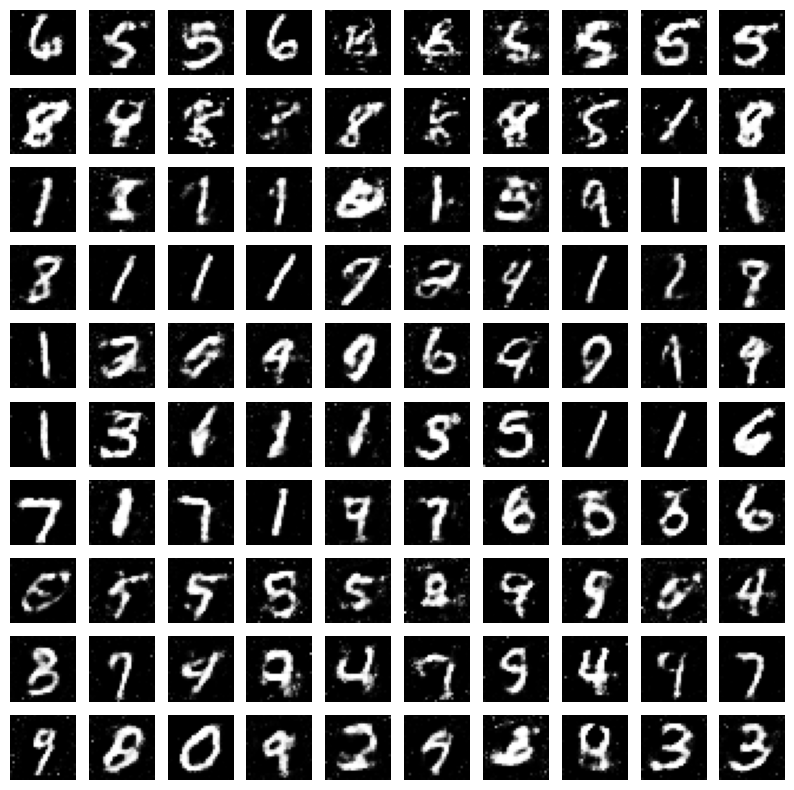

In [ ]:
generate_test_examples(generator)

### Lambda =100

In [15]:
lambda_ = 100
epochs = 100
batch_size = 100

In [16]:
real_classification_accuracy =[]
fake_classification_accuracy =[]

for epoch in range(epochs):
    for i in range(x_train.shape[0] // batch_size):
        idx = np.random.normal(0,1,size = (batch_size, 100))
        
        real_image_index=i*batch_size
        real_center_p=center_patches[real_image_index:real_image_index+batch_size]
        gen_input = tf.concat([idx, real_center_p], axis=1)
        
        generated_images = generator.predict(gen_input)
        
        real_images = tf.reshape(x_train[np.random.randint(0, x_train.shape[0], batch_size)],(-1,784))
        
        labels_real = np.ones((batch_size, 1))
        labels_fake = np.zeros((batch_size, 1))
        discriminator.trainable = True

        d_loss_real, real_accuracy = discriminator.train_on_batch(real_images, labels_real)
        d_loss_fake, fake_accuracy = discriminator.train_on_batch(generated_images, labels_fake)
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
        
        gen_center_patch =generated_images.reshape(batch_size, 28,28)
        gen_center_patch=gen_center_patch[:, 10:20, 10:20].reshape(batch_size, 100)
        idx = np.random.normal(0,1,size = (batch_size, 100))

        gan_input = tf.concat([idx, center_patches[real_image_index:real_image_index+batch_size]], axis=1)
        discriminator.trainable = False

        g_loss = combined_model.train_on_batch(gan_input, labels_real)+(lambda_ * np.mean((gen_center_patch-real_center_p)**2))

        print(f"Epoch {epoch}, D Loss: {d_loss}, G Loss: {g_loss}")
    real_classification_accuracy.append(real_accuracy)
    fake_classification_accuracy.append(fake_accuracy)

4/4 [==============================] - 0s 3ms/step
Epoch 0, D Loss: 0.8920866847038269, G Loss: 133.17162829637527
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.4413633346557617, G Loss: 129.58046805858612
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.34594959020614624, G Loss: 129.64135766029358
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.272433090955019, G Loss: 130.4432049393654
4/4 [==============================] - 0s 3ms/step
Epoch 0, D Loss: 0.27862132899463177, G Loss: 132.41393065452576
4/4 [==============================] - 0s 3ms/step
Epoch 0, D Loss: 0.29604741372168064, G Loss: 129.85598528385162
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.23888999968767166, G Loss: 134.81821036338806
4/4 [==============================] - 0s 3ms/step
Epoch 0, D Loss: 0.20457196095958352, G Loss: 131.21977698802948
4/4 [==============================] - 0s 2ms/step
Epoch 0, D Loss: 0.1983452

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 33, D Loss: 0.506032720208168, G Loss: 128.28903138637543
4/4 [==============================] - 0s 3ms/step
Epoch 33, D Loss: 0.5948576331138611, G Loss: 125.5464414358139
4/4 [==============================] - 0s 2ms/step
Epoch 33, D Loss: 0.49944262206554413, G Loss: 121.90185022354126
4/4 [==============================] - 0s 2ms/step
Epoch 33, D Loss: 0.3831658363342285, G Loss: 118.11629045009613
4/4 [==============================] - 0s 2ms/step
Epoch 33, D Loss: 0.48237253725528717, G Loss: 121.48814857006073
4/4 [==============================] - 0s 2ms/step
Epoch 33, D Loss: 0.38901716470718384, G Loss: 111.88680100440979
4/4 [==============================] - 0s 2ms/step
Epoch 33, D Loss: 0.49867452681064606, G Loss: 122.25502264499664
4/4 [==============================] - 0s 2ms/step
Epoch 33, D Loss: 0.5057661235332489, G Loss: 129.3989623785019
4/4 [==============================] - 0s 2ms/step
Epoch 33, D Loss: 0.42080117762088776, G Loss: 121.57803761959076
4/4 [

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 51, D Loss: 0.5389852225780487, G Loss: 126.64705991744995
4/4 [==============================] - 0s 3ms/step
Epoch 51, D Loss: 0.5355975925922394, G Loss: 120.49915766716003
4/4 [==============================] - 0s 2ms/step
Epoch 51, D Loss: 0.5166092067956924, G Loss: 119.32539904117584
4/4 [==============================] - 0s 3ms/step
Epoch 51, D Loss: 0.5195003300905228, G Loss: 121.51606810092926
4/4 [==============================] - 0s 3ms/step
Epoch 51, D Loss: 0.4949279874563217, G Loss: 121.55477631092072
4/4 [==============================] - 0s 2ms/step
Epoch 51, D Loss: 0.48890823125839233, G Loss: 122.65162813663483
4/4 [==============================] - 0s 2ms/step
Epoch 51, D Loss: 0.4730907827615738, G Loss: 121.12513244152069
4/4 [==============================] - 0s 3ms/step
Epoch 51, D Loss: 0.5067162811756134, G Loss: 129.49329245090485
4/4 [==============================] - 0s 2ms/step
Epoch 51, D Loss: 0.43939583003520966, G Loss: 117.49311792850494
4/4 [

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 82, D Loss: 0.5977953374385834, G Loss: 119.70869016647339
4/4 [==============================] - 0s 2ms/step
Epoch 82, D Loss: 0.5605208575725555, G Loss: 115.61925172805786
4/4 [==============================] - 0s 2ms/step
Epoch 82, D Loss: 0.5661195814609528, G Loss: 129.7468945980072
4/4 [==============================] - 0s 2ms/step
Epoch 82, D Loss: 0.556380033493042, G Loss: 118.0338921546936
4/4 [==============================] - 0s 2ms/step
Epoch 82, D Loss: 0.5639421939849854, G Loss: 110.8253732919693
4/4 [==============================] - 0s 2ms/step
Epoch 82, D Loss: 0.5146284997463226, G Loss: 117.79058992862701
4/4 [==============================] - 0s 2ms/step
Epoch 82, D Loss: 0.5703779458999634, G Loss: 117.09849798679352
4/4 [==============================] - 0s 3ms/step
Epoch 82, D Loss: 0.563679426908493, G Loss: 123.01481354236603
4/4 [==============================] - 0s 2ms/step
Epoch 82, D Loss: 0.5143482089042664, G Loss: 132.5858896970749
4/4 [========

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Epoch 87, D Loss: 0.6060039401054382, G Loss: 133.14017832279205
4/4 [==============================] - 0s 2ms/step
Epoch 87, D Loss: 0.5515275597572327, G Loss: 127.43695783615112
4/4 [==============================] - 0s 2ms/step
Epoch 87, D Loss: 0.5530421137809753, G Loss: 127.20675110816956
4/4 [==============================] - 0s 2ms/step
Epoch 87, D Loss: 0.5370367765426636, G Loss: 115.30086255073547
4/4 [==============================] - 0s 2ms/step
Epoch 87, D Loss: 0.6010186672210693, G Loss: 124.987952709198
4/4 [==============================] - 0s 2ms/step
Epoch 87, D Loss: 0.6042293012142181, G Loss: 125.46378874778748
4/4 [==============================] - 0s 2ms/step
Epoch 87, D Loss: 0.5403911471366882, G Loss: 131.21337568759918
4/4 [==============================] - 0s 2ms/step
Epoch 87, D Loss: 0.5588454306125641, G Loss: 126.96008718013763
4/4 [==============================] - 0s 2ms/step
Epoch 87, D Loss: 0.5259555876255035, G Loss: 122.86189889907837
4/4 [====

100
100


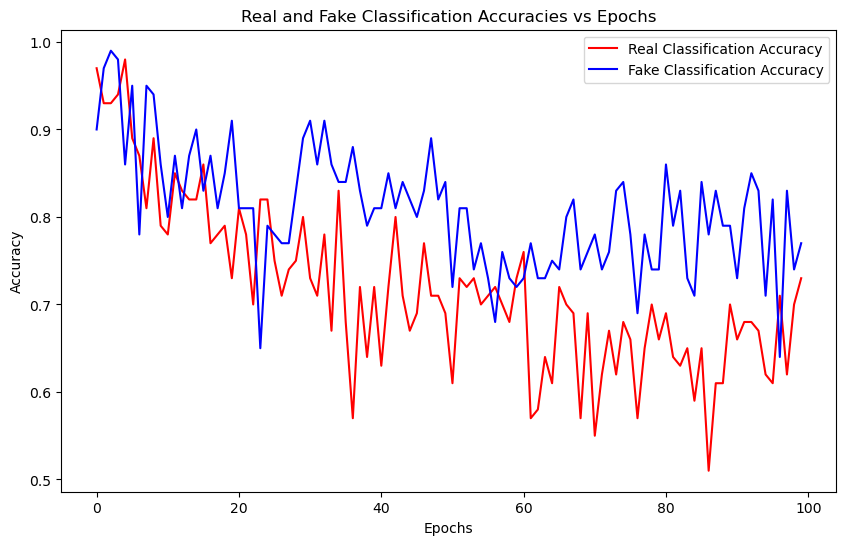

In [17]:
plt.figure(figsize=(10, 6))
print(len(real_classification_accuracy))
print(len(fake_classification_accuracy))

plt.plot(np.arange(epochs),real_classification_accuracy, color='red', label='Real Classification Accuracy')
plt.plot(np.arange(epochs), fake_classification_accuracy, color='blue', label='Fake Classification Accuracy')

plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Real and Fake Classification Accuracies vs Epochs')

plt.legend()
plt.show()


In [18]:
generator.save_weights("q4_imputing_gan_weights_l100.h5")
generator.save("q4_imputing_gan_model_l100.h5")

In [29]:
def generate_test_examples(generator, num_examples_per_class=10):
    fig, axes = plt.subplots(10, num_examples_per_class, figsize=(num_examples_per_class, 10))

    for digit in range(10):
        for i in range(num_examples_per_class):
            idx = tf.random.normal((1, 100))
            index=np.where(y_test == digit)[0][i]
            generated_image=generator.predict(tf.concat([idx,x_test[index, 10:20, 10:20].reshape(1, 100)],axis=1))
            axes[digit, i].imshow(generated_image.reshape(28, 28), cmap='gray')
            axes[digit, i].axis('off')

    plt.show()




1/1 [==============================] - 0s 15ms/step


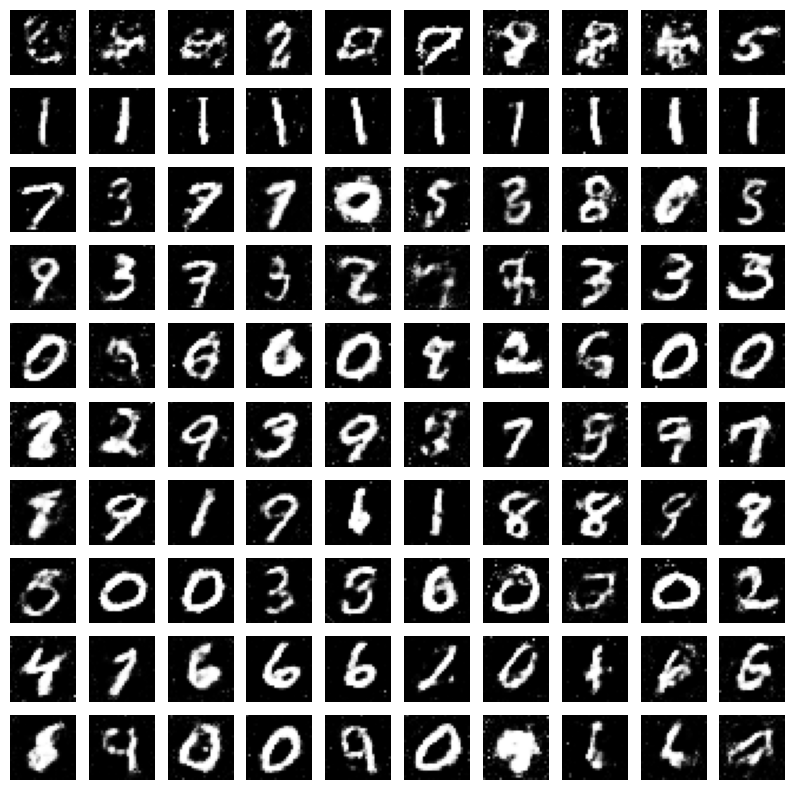

In [30]:
generate_test_examples(generator)